In [33]:
import matplotlib.pyplot as plt
import math
import numpy as np
import pandas as pd
%matplotlib inline
import seaborn as sns
#import librosa.display
#import librosa

In [2]:
audio_path = r'C:\Users\Daniele\Desktop\prova\chop_registrata.wav'

In [3]:
x , sr = librosa.load(audio_path,sr=44100)

In [4]:
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(3976753,) 44100


In [79]:
import IPython.display as ipd
ipd.Audio(audio_path)

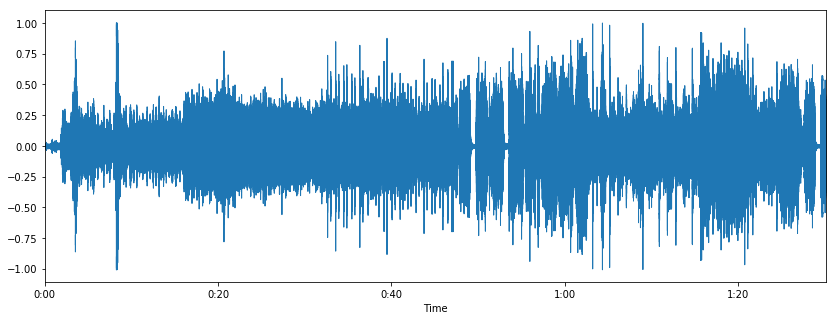

In [24]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

In [7]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
len(Xdb.shape)


2

In [8]:
Xdb

array([[-26.70174 , -26.70174 , -26.70174 , ..., -22.64626 , -24.267092,
        -17.11745 ],
       [-26.70174 , -26.70174 , -26.70174 , ..., -10.644979, -13.844768,
        -15.371296],
       [-26.70174 , -26.70174 , -26.70174 , ...,  -3.90187 ,  -9.77054 ,
         -4.34159 ],
       ...,
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.16125 ],
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.156116],
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.161402]], dtype=float32)

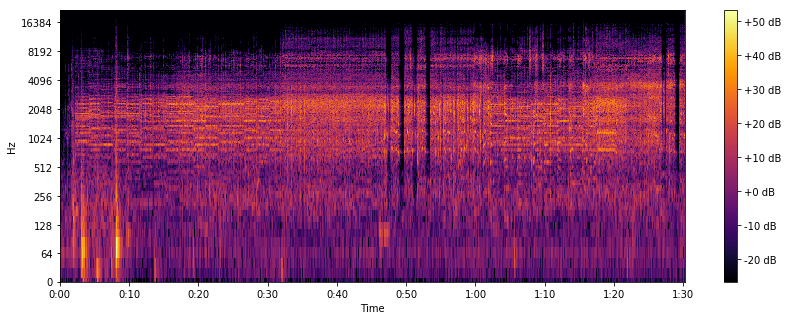

In [10]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz',cmap='inferno')
plt.colorbar()

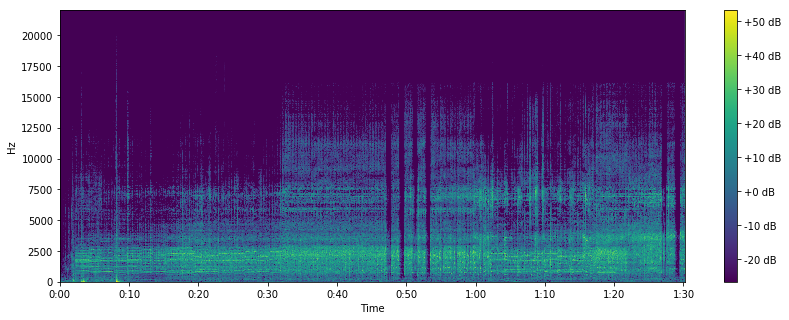

In [11]:
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz',cmap='viridis')
plt.colorbar(format='%+2.0f dB')


In [15]:
df=pd.read_csv(r'C:\Users\Daniele\Desktop\prova\prova')

In [21]:
df.head(10)

,relative_time,PitchSensor
0,0,0.000000
1,80,0.000000
2,200,0.000000
3,280,0.000000
4,361,0.000000
5,487,46.865234
6,520,46.865234
7,560,46.865234
8,566,38.061523
9,567,38.061523


In [16]:
conv_arr= df.values

In [11]:
D=np.ravel(df['PitchSensor'])

In [17]:
D1=np.ravel(conv_arr)

In [12]:
type(D)==type(x)

True

In [13]:
Xdb

array([[-26.70174 , -26.70174 , -26.70174 , ..., -22.64626 , -24.267092,
        -17.11745 ],
       [-26.70174 , -26.70174 , -26.70174 , ..., -10.644979, -13.844768,
        -15.371296],
       [-26.70174 , -26.70174 , -26.70174 , ...,  -3.90187 ,  -9.77054 ,
         -4.34159 ],
       ...,
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.16125 ],
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.156116],
       [-26.70174 , -26.70174 , -26.70174 , ..., -26.70174 , -26.70174 ,
        -23.161402]], dtype=float32)

In [16]:
from sklearn.preprocessing import StandardScaler

In [14]:
import seaborn as sns

In [17]:
scaler=StandardScaler()

In [18]:
scaler.fit(Xdb)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [19]:
test=scaler.transform(Xdb)

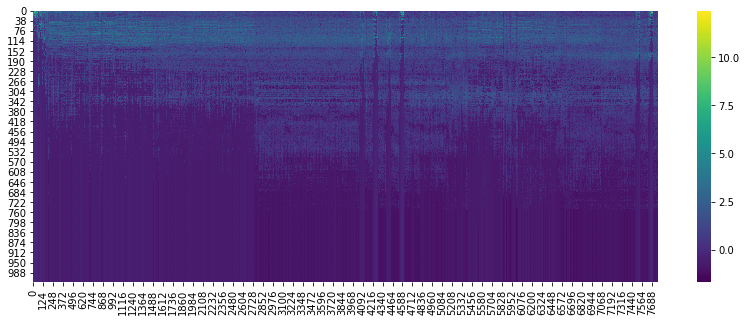

In [29]:
fig, ax = plt.subplots(figsize=(14,5))         # Sample figsize in inches
sns.heatmap(test,ax=ax,cmap='viridis')

In [30]:
test

array([[-0.14536585, -0.14536585, -0.14536585, ..., -0.79231393,
        -0.9365972 , -0.6018873 ],
       [-0.14536585, -0.14536585, -0.14536585, ..., -0.00868311,
        -0.24350663, -0.47374365],
       [-0.14536585, -0.14536585, -0.14536585, ...,  0.4316122 ,
         0.02743187,  0.33568463],
       ...,
       [-0.14536585, -0.14536585, -0.14536585, ..., -1.057119  ,
        -1.0985028 , -1.0454187 ],
       [-0.14536585, -0.14536585, -0.14536585, ..., -1.057119  ,
        -1.0985028 , -1.045042  ],
       [-0.14536585, -0.14536585, -0.14536585, ..., -1.057119  ,
        -1.0985028 , -1.04543   ]], dtype=float32)

In [5]:
two_sensor = pd.read_csv(r'rec.csv')

In [6]:
a = [i for i in two_sensor['PitchSensor'].isna() if i == True]

In [7]:
len(a)

410

In [8]:
len(two_sensor['PitchSensor'])

1353

In [9]:
lista = two_sensor['PitchSensor'].tolist()

In [10]:
# dealing with NaN values

for i in range(len(lista)):
    if math.isnan(lista[i])==True:
        if i == 0:
            lista[i]=0.0
        else:
            lista[i]=lista[i-1]

In [11]:
two_sensor['PitchSensor'] = lista

In [23]:
x = np.array(two_sensor['relative_time'].tolist())
y = np.array(two_sensor['PitchSensor'].tolist())
z = np.array(two_sensor['DecibelSource'].tolist())

In [25]:
x = np.unique(x)
y = np.unique(y)
z = np.unique(z)

In [45]:
two_sensor.head()

,relative_time,DecibelSource,PitchSensor
0,0,25.658478,0.0
1,17,25.658478,0.0
2,77,25.145478,0.0
3,152,18.260748,0.0
4,212,16.989700,0.0


In [22]:
two_sensor['relative_time'] = pd.to_numeric(two_sensor['relative_time'])
two_sensor['PitchSensor'] = pd.to_numeric(two_sensor['PitchSensor'])
two_sensor['DecibelSource'] = pd.to_numeric(two_sensor['DecibelSource'])

In [53]:
len(np.unique(np.array(two_sensor['relative_time'])))

1353

In [48]:
table = two_sensor.pivot(index = 'PitchSensor',columns = 'relative_time')  

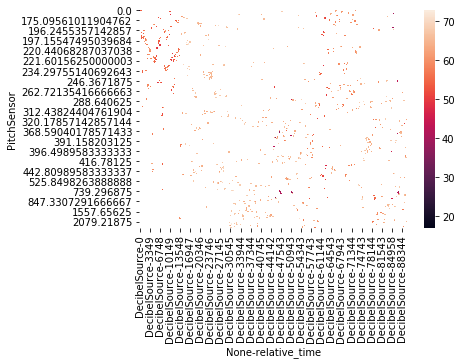

In [44]:
ax = sns.heatmap(table)